This notebook provides some sample code to illustrate how to use and interpret returned data from the OrthoCoverage API along with the ExtractOrthoImage. For any questions about it, please reach out to pat.edwards@vexcelgroup.com - he'll be happy to walk you through any of the concepts.

## Step 1: pull in all of the coverage data

The cell below uses the OrthoCoverage API to pull down the coverage information in terms of GeoJSON features for our entire bluesky library (bluesky imagery is captured in optimal flying conditions, graysky is captured as soon as is safe after a disaster).

In [5]:
import json
import requests
import geopandas as gpd
import copy

from vdp_python_tools.authentication import login

token = login()


In [6]:

# WA = wide area, this program captures 20cm GSD data
wa_layers = ["bluesky-high-europe", "bluesky-high"]
# UA = urban area, this program captures 7.5cm GSD data
ua_layers = ['bluesky-ultra',
 'bluesky-ultra-europe',
 'bluesky-ultra-g',
 'bluesky-ultra-oceania',]

other_layers = ["graysky", "graysky-g"] # from our "Gray Sky" disaster response program

raw_features = []
for layer_name in ua_layers + wa_layers:
    r = requests.get(f"https://api.gic.org/metadata/OrthoCoverage/?token={token}&layer={layer_name}")
    raw_features += r.json()['features']

The above code searches our worldwide library, but breaks it into layers to ensure the responses aren't too large. If you're searching smaller areas, you can query based on a WKT geometry for all layers, see below:

In [3]:
wkt = "POLYGON((-119.28360349311511 46.28209334880357, -119.28362784211994 46.28022542305201, -119.28068507792784 46.280244655449444, -119.2808590001489 46.28212700453064, -119.28360349311511 46.28209334880357))"

r = requests.get(f"https://api.gic.org/metadata/OrthoCoverage/?token={token}&wkt={wkt}")
raw_features_wkt_limited = r.json()['features']

The output from the coverage API is GeoJSON. E.g the first element of the array `raw_features_alt` above looks like:
```
{'type': 'Feature',
 'properties': {'AOI': 'us-wa-kennewickpasco-2021',
  'Coverage Type': 'final-ortho',
  'Min GSD': 0.054384235,
  'Max GSD': 0.0756772,
  'Min Capture date': '2021-04-16 08:11:21',
  'Max Capture date': '2021-04-17 09:45:47',
  'layer': 'bluesky-ultra',
  'AOI Area': 907.072,
  'AOI Max Zoom': 21,
  'AOI Pretty Name': ''},
 'geometry': {'type': 'MultiPolygon',
  'coordinates': [[[[-119.1507, 46.1182],
       ...
     [-119.0613, 46.1199],
     [-119.1507, 46.1182]]]]},
 'Child AOI': [{'Name': 'us-wa-kennewickpasco-2021',
   'Coverage Type': 'final-ortho',
   'Coverage': {'type': 'MultiPolygon',
    'coordinates': [[[[-119.1507, 46.1182],
       ...
       [-119.1507, 46.1182]]]]},
   'Min GSD': 0.054384235,
   'Max GSD': 0.0756772,
   'Min Date': '2021-04-16 08:11:21',
   'Max Date': '2021-04-17 09:45:47',
   'Max Zoom': 21,
   'Z Index': 50,
   'Camera Technology': ''}]}
```

All of our data captures are grouped into AOIs (Area's of Interest). As this happens over a number of days - we have to fly while the sun is above the horizon by more than 30 degrees and only fly in clear skies - there is a Min and Max capture date field. There's also a geometry showing the footprint of that AOI. 

In many cases, there are Child AOI's that contain similar attributes. For the most granular results on the coverage available, it's best to look at the Child AOIs. This can be done a number of ways, but one way is presented below where the nested parent-child AOIs are flattened and then transformed into a table that can be saved a Shapefile or GeoJSON.

In [7]:
"""
This function is used to pull the child AOIs out of their parents to flatten the nested data into a flat set of features
"""

def process_coverage_aoi_features(features):
    ortho_features = []

    for feature in features:
        children = feature.get("Child AOI", [])
        if len(children) <= 1:
            ortho_features.append(feature)
        else:
            ortho_features.extend([child_to_feature(child, feature) for child in children])
            
    for feature in ortho_features:
        if "Name" in feature["properties"]:
            feature["properties"]["aoi_name"] = feature["properties"]["Name"]
        elif "AOI" in feature["properties"]:
            feature["properties"]["aoi_name"] = feature["properties"]["AOI"]
    return ortho_features


def child_to_feature(child, parent):
    feature = {"geometry": child['Coverage']}
    del child['Coverage']
    feature["properties"] = child
    feature["properties"]["layer"] = parent["properties"]["layer"]
    feature["properties"]["Coverage Type"] = parent["properties"]["Coverage Type"]
    feature["properties"]["Parent AOI"] = parent["properties"]["AOI"]
    return feature


ortho_features = process_coverage_aoi_features(copy.deepcopy(raw_features))
ortho_features_wkt_limited = process_coverage_aoi_features(copy.deepcopy(raw_features_wkt_limited))

We can create a table of every AOI that we have available by importing these features into GeoPandas

In [8]:
gdf_existing_coverage = gpd.GeoDataFrame.from_features(ortho_features)
gdf_existing_coverage_wkt_limited = gpd.GeoDataFrame.from_features(ortho_features_wkt_limited)
gdf_existing_coverage_wkt_limited

,geometry,AOI,Coverage Type,Min GSD,Max GSD,Min Capture date,Max Capture date,layer,AOI Area,AOI Max Zoom,AOI Pretty Name,aoi_name
0,"MULTIPOLYGON (((-119.15070 46.11820, -119.1544...",us-wa-kennewickpasco-2021,final-ortho,0.054384,0.075677,2021-04-16 08:11:21,2021-04-17 09:45:47,bluesky-ultra,907.07200,21,,us-wa-kennewickpasco-2021
1,"MULTIPOLYGON (((-118.99900 46.12250, -119.0026...",us-wa-kennewickpasco-2020,final-ortho,0.050020,0.075329,2020-06-04 03:21:07,2020-07-02 08:50:22,bluesky-ultra,821.46730,21,,us-wa-kennewickpasco-2020
2,"MULTIPOLYGON (((-119.42800 46.37210, -119.4278...",us-wa-kennewick_leica-2019,quick-ortho,0.026716,0.057065,2018-07-18 05:13:19,2019-06-14 07:36:55,bluesky-ultra-g,738.25240,21,,us-wa-kennewick_leica-2019
3,"MULTIPOLYGON (((-73.14920 42.96410, -73.14940 ...",USUSCON2001,dxm-ortho,0.090758,0.209981,2020-05-15 04:15:07,2021-03-04 03:50:26,bluesky-high,231224.84000,20,,USUSCON2001
4,"MULTIPOLYGON (((-119.42490 46.33100, -119.4249...",us-wa-kennewick-2018,quick-ortho,0.053925,0.075606,2018-07-17 12:00:01,2018-07-21 04:18:50,bluesky-ultra,521.95636,21,,us-wa-kennewick-2018


You can also check coverage for DSM and DTM data. 

In [9]:
wkt = "POLYGON((-119.28360349311511 46.28209334880357, -119.28362784211994 46.28022542305201, -119.28068507792784 46.280244655449444, -119.2808590001489 46.28212700453064, -119.28360349311511 46.28209334880357))"

r = requests.get(f"https://api.gic.org/metadata/DSMCoverage/?token={token}&wkt={wkt}")
raw_features_dsm = r.json()['features']
gdf_dsm_coverage_sample = gpd.GeoDataFrame.from_features(raw_features_dsm)
gdf_dsm_coverage_sample

,geometry,AOI,Coverage Type,Min GSD,Max GSD,Min Capture date,Max Capture date,layer,AOI Area,AOI Max Zoom,AOI Pretty Name
0,"MULTIPOLYGON (((-119.43260 46.37120, -119.4290...",us-wa-kennewickpasco-2020,dsm,0.049675,0.075409,2020-06-04 03:21:07,2020-07-02 08:50:22,bluesky-ultra,8.183571e+02,21,
1,"MULTIPOLYGON (((-119.43280 46.37460, -119.4291...",us-wa-kennewickpasco-2021,dsm,0.054384,0.075677,2021-04-16 08:11:21,2021-04-17 09:45:47,bluesky-ultra,8.374477e+02,21,
2,"MULTIPOLYGON (((-76.06010 38.98710, -76.07590 ...",USUSCON2001,dsm,0.068264,0.221453,2019-11-12 05:40:45,2021-03-04 03:50:26,bluesky-high,1.288688e+06,20,


To save the coverage data, just use the to_file method of GeoPandas

In [14]:
import os

os.makedirs("./data/tmp", exist_ok=True)
# gdf_dsm_coverage_sample.to_file("./data/tmp/dsm_coverage.shp") # works, but will give warning that column names are truncated
gdf_dsm_coverage_sample.to_file("./data/tmp/dsm_coverage.geojson", drive="GeoJSON")

There is some inconsistency in the way that fields are named in the responses, so the cell below consolidates some fields.

In [15]:
import pandas as pd
import numpy as np 

gdf_existing_coverage['Max Capture date'] = gdf_existing_coverage.apply(lambda row: row['Max Date'] if type(row['Max Date']) != float else row['Max Capture date'], axis=1)
gdf_existing_coverage['most_recent_capture'] = pd.to_datetime(gdf_existing_coverage['Max Capture date'])

In [16]:
gdf_existing_coverage['centroid'] = gdf_existing_coverage.geometry.centroid.apply(lambda g: g.wkt)

In [17]:
gdf_existing_coverage.head()

,geometry,AOI,Coverage Type,Min GSD,Max GSD,Min Capture date,Max Capture date,layer,AOI Area,AOI Max Zoom,...,aoi_name,Name,Min Date,Max Date,Max Zoom,Z Index,Camera Technology,Parent AOI,most_recent_capture,centroid
0,"MULTIPOLYGON (((-106.81550 34.75710, -106.8148...",us-nm-loslunas-2021,quick-ortho,0.060519,0.075334,2021-11-02 07:23:35,2021-11-05 05:31:16,bluesky-ultra,626.37396,21.0,...,us-nm-loslunas-2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2021-11-05 05:31:16,POINT (-106.7041590581676 34.74920050239641)
1,"MULTIPOLYGON (((-102.00620 35.26170, -102.0059...",us-tx-amarillo-2021,quick-ortho,0.069882,0.075117,2021-10-30 07:12:32,2021-11-01 08:13:26,bluesky-ultra,979.27730,21.0,...,us-tx-amarillo-2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2021-11-01 08:13:26,POINT (-101.82834774956 35.19491722142268)
2,"MULTIPOLYGON (((-84.20900 33.50780, -84.20790 ...",us-ga-redan-2021,quick-ortho,0.062426,0.074207,2021-10-23 02:44:47,2021-11-12 04:05:37,bluesky-ultra,2323.18330,21.0,...,us-ga-redan-2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2021-11-12 04:05:37,POINT (-83.95767121022864 33.66546575478327)
3,"MULTIPOLYGON (((-112.56370 34.57370, -112.5635...",us-az-prescottvalleyprescott-2021,quick-ortho,0.052269,0.075514,2021-10-21 07:26:43,2021-10-22 10:05:16,bluesky-ultra,480.34094,21.0,...,us-az-prescottvalleyprescott-2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2021-10-22 10:05:16,POINT (-112.3879075467854 34.58186585584939)
4,"MULTIPOLYGON (((-84.15680 34.31150, -84.15650 ...",us-ga-gainesville-2021,quick-ortho,0.061402,0.083319,2021-10-17 02:28:13,2021-10-23 05:05:00,bluesky-ultra,1833.03210,21.0,...,us-ga-gainesville-2021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2021-10-23 05:05:00,POINT (-83.90335494411752 34.23624762410684)


The rest of this notebook shows how to use the data from the table above to fetch orthorectified imagery with a known date, GSD and coverage type by utilising the AOI field in tile services.

Without using the AOI field, the ExtractOrthoImages API returns an image using the most recent AOI. The ExtractOrthoImages is a new API (released September 2021) and can be used when users want to obtain orthorectified imagery over a large area. Previously they would have to either:
- use a discrete image API such as ExtractImages and not use orthorectified imagery, or
- use the GetOrthoImage tile for multiple tiles in an area and then stitch them together with their own functions


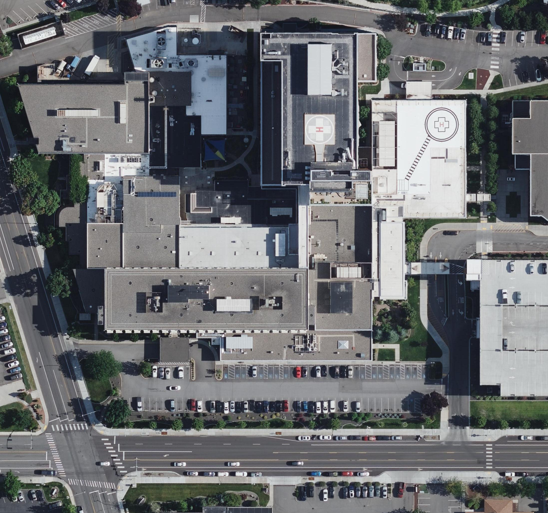

In [18]:
from PIL import Image

# since this is the most recent AOI, it's the same as the image above
layer = "bluesky-ultra"
aoi = "us-wa-kennewickpasco-2020" # see where raw_features_alt was defined earlier, this is from the first feature in that
url = f"https://api.gic.org/images/ExtractOrthoImages?layer={layer}&epsg=4326&token={token}&wkt={wkt}&AOI={aoi}"

response = requests.get(url, stream = True)
image = Image.open(response.raw)

w, h = image.size
image.resize((int(w/4), int(h/4))) # resizing for display

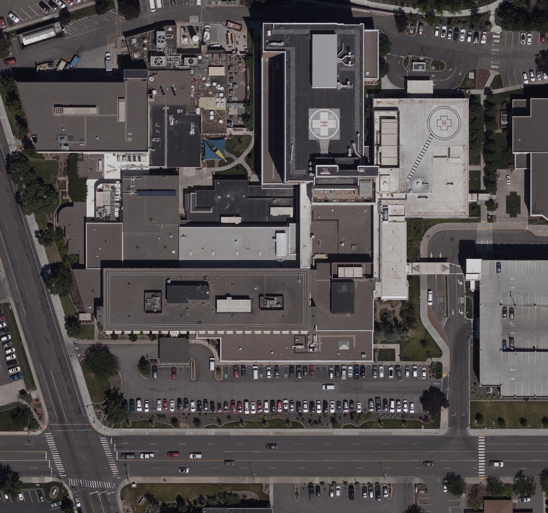

In [19]:
layer = "bluesky-ultra"
aoi = "us-wa-kennewick-2018" # see where raw_features_alt was defined earlier, this is from the second feature in that
url = f"https://api.gic.org/images/ExtractOrthoImages?layer={layer}&epsg=4326&token={token}&wkt={wkt}&AOI={aoi}"

response = requests.get(url, stream = True)
image = Image.open(response.raw)

w, h = image.size
image.resize((int(w/4), int(h/4))) # resizing for display

Importantly, when using the ExtractOrthoImage API, no more than 135 tiles will be stitched. See the [documentation](https://vexcel.atlassian.net/servicedesk/customer/portal/15/article/2093875571) for more information, or below for an exerpt:

```
All use cases will ensure that imagery will not exceed either 4K resolution (4096 x 2160 = 8847360 pixels) or 135 tiles.

- wkt: In this case zoom of the tiles will be the best (higher) zoom that the layer can offer which can cover the region defined by the wkt with 135 or less tiles.

- wkt + zoom: In this case zoom of the tiles will be the minimum of the provided zoom and the best (higher) zoom that the layer can offer which can cover the region defined by the wkt with 135 or less tiles.

- xcoordinate + ycoordinate + zoom + width + height: In this case tiles of requested zoom will be used centered on requested point as long as width x height is less or equal to 8847360.
```

While this notebook uses the ExtractOrthoImage API, the [GetOrthoImageTile](https://vexcel.atlassian.net/servicedesk/customer/portal/15/article/1392181901) also has an AOI field that can be used.

The rest of this notebook covers the display of that data and is not fully polished.


In [20]:
import pandas as pd
import folium
import datetime
import math

gdf_existing_coverage['age'] = gdf_existing_coverage.most_recent_capture.apply(lambda d: (datetime.datetime.today() - d).days/365)

gdf_existing_coverage = gdf_existing_coverage.sort_values(by=['age'], ascending=False)

import leafmap.leafmap as leafmap

gdf_existing_coverage = gdf_existing_coverage.set_crs(epsg=4326)
gdf_existing_coverage.geometry = gdf_existing_coverage.geometry.to_crs(epsg=4326)


gdf_to_plot = gdf_existing_coverage[['age', 'geometry']]


In [21]:
import branca
import os

m = folium.Map(location=[48, -102], tiles="cartodbpositron", zoom_start=3)
geojson = json.loads(gdf_to_plot[['age', 'geometry']].to_json())
colorscale = branca.colormap.linear.YlGnBu_09.scale(0, 5)

def style_function(feature):
    return {
        "fillOpacity": 0.8,
        "weight": 0,
        "fillColor": colorscale(feature['properties']['age'])
    }

folium.GeoJson(
    geojson,
    style_function=style_function,
).add_to(m)

colorscale.add_to(m)
os.makedirs("./data/tmp", exist_ok=True)


In [22]:
m.save('./data/tmp/coverage_age_in_years.html')
m